# Task-4 Image Reconstruction using Matrix Factorisation

### Importing Required Libraries

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns

# remove all warnings
import warnings
warnings.filterwarnings('ignore')

%matplotlib inline
%config InlineBackend.figure_format = 'retina'


try:
    from einops import rearrange
except ImportError:
    %pip install einops
    from einops import rearrange

In [2]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torchvision

# check if CUDA is available
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print('Using device:', device)
print('Number of GPUs:', torch.cuda.device_count())
torch.cuda.set_device(0)


Using device: cuda
Number of GPUs: 1


In [3]:
# Setting the seed for Python, NumPy, and PyTorch (both CPU and GPU)
def set_seed(seed=42):
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)  # if using CUDA
    torch.cuda.manual_seed_all(seed)  # for multi-GPU
    torch.backends.cudnn.deterministic = True  # Ensures deterministic behavior
    torch.backends.cudnn.benchmark = False     # Disables the auto-tuner that finds the best algorithm

set_seed(42)

### Matrix Factorization Functions

In [4]:
# Function to normalize the image
def normalize_image(image_tensor):
    image_tensor = image_tensor.float() / 255.0
    return image_tensor


def mask_image(image, mask_proportion=0.1, mask_value = float('nan')):
    if not isinstance(image, torch.Tensor):
        raise TypeError("Input 'image' must be a torch.Tensor.")
    
    if not (0 <= mask_proportion <= 1):
        raise ValueError("'mask_proportion' must be between 0 and 1.")
    
    img_copy = image.clone()
    mask = torch.rand(image.shape) < mask_proportion
    img_copy[mask] = mask_value

    return img_copy, mask


def matrix_factorization(image_tensor, rank, learning_rate=0.01, num_epochs=5000, tol = 1e-6, device=torch.device("cpu")):
    """
    Perform matrix factorization using Alternating Least Squares (ALS) algorithm.
    
    Args:
        image_tensor (torch.Tensor): The image tensor to be factorized.
        rank (int): The rank of the factorization.
        learning_rate (float): The learning rate for optimization.
        num_epochs (int): The number of epochs to train the model.
        tol (float): The tolerance for convergence.
        device (torch.device): The device to run the optimization.
    
    Returns:
        W (torch.Tensor): The basis matrix.
        H (torch.Tensor): The coefficient matrix.
        loss (torch.Tensor): The final loss.
        losses (list): The list of losses at each epoch.
    """

    image_tensor = image_tensor.to(device)
    height, width = image_tensor.shape
    # Initialize the factors randomly
    W = torch.randn(height, rank, requires_grad=True, device=device)
    H = torch.randn(rank, width, requires_grad=True, device=device)
    # Optimizer
    optimizer = optim.Adam([W, H], lr=learning_rate)
    mask = ~torch.isnan(image_tensor)
    # Train the model
    losses = []
    prev_loss = float('inf')
    for i in range(1, num_epochs+1):
        # Compute the loss
        diff_matrix = torch.mm(W, H) - image_tensor
        diff_vector = diff_matrix[mask]
        loss = torch.norm(diff_vector)
        losses.append(loss.item())
        if i % 1000 == 0:
            print(f"Iteration {i}, loss: {loss.item()}")

        if abs(prev_loss - loss.item()) < tol:
            print(f"Converged at iteration {i}, loss: {loss.item()}")
            break
        prev_loss = loss.item()
        
        # Zero the gradients
        optimizer.zero_grad()

        # Backpropagate
        loss.backward()

        # Update the parameters
        optimizer.step()

    return W, H, loss, losses


def plot_images(original, masked, reconstructed,rank, mask_value):
    fig, axes = plt.subplots(1, 3, figsize=(15, 5))
    fig.suptitle(f"Image Reconstruction with Rank={rank} and Mask={mask_value}")
    # Original image
    axes[0].imshow(original.cpu().detach().numpy(), cmap='gray')
    axes[0].set_title("Original Image")
    axes[0].axis('off')
    # Masked image
    axes[1].imshow(masked.cpu().detach().numpy(), cmap='gray')
    axes[1].set_title("Masked Image")
    axes[1].axis('off')
    # Reconstructed image
    axes[2].imshow(reconstructed.cpu().detach().numpy(), cmap='gray')
    axes[2].set_title("Reconstructed Image")
    axes[2].axis('off')
    plt.show()


def calculate_rmse_psnr(original, reconstructed):
    # Ensure both tensors are on the same device
    if original.device != reconstructed.device:
        original = original.to(reconstructed.device)
    mse = F.mse_loss(reconstructed, original)
    rmse = torch.sqrt(mse)
    print(f"RMSE: {rmse.item()}")
    # PSNR: Peak Signal to Noise Ratio
    max_pixel_value = 1.0  # Since image is normalized to [0,1]
    psnr = 20 * torch.log10(max_pixel_value / torch.sqrt(mse))
    print(f"PSNR: {psnr.item()}")
    return rmse.item(), psnr.item()

# Question 4.1

Q1. Pick an image of your liking and reconstruct it using matrix factorization. Choose a suitable value for the rank 
r
. Run Gradient Descent until it converges, plot the reconstructed image alongside the original image. Calculate and report the RMSE and PSNR metrics.

### Load Image

In [5]:
# image completion
import os

if os.path.exists("iitgn.jpg"):
    print("iitgn.jpg already exists")
else:
    !curl -o iitgn.jpg "https://news.iitgn.ac.in/wp/wp-content/uploads/2019/07/ANK383_2224a-1280x640.jpg"

iitgn.jpg already exists


Min pixel value: 0.0
Max pixel value: 1.0


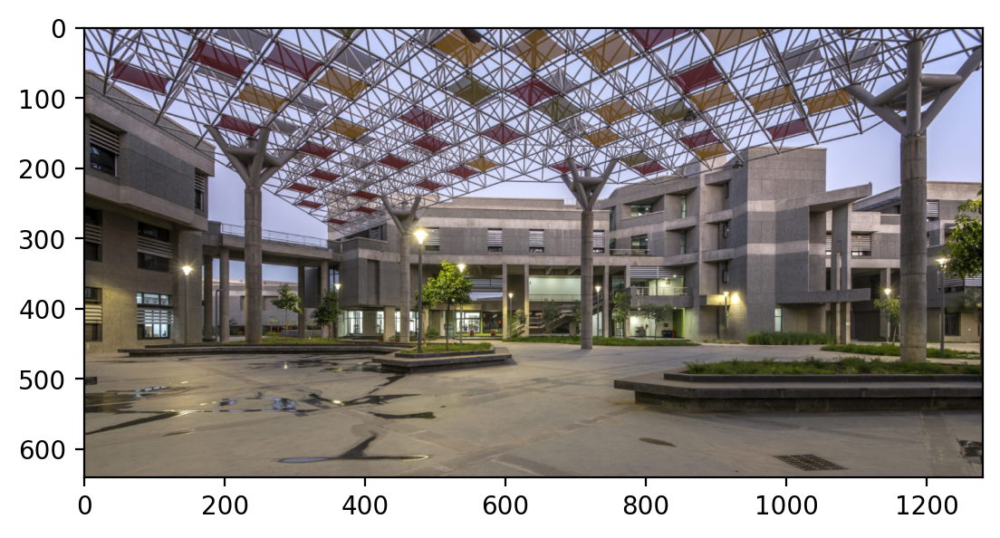

In [6]:
# Load and preprocess image
color_img = torchvision.io.read_image("./iitgn.jpg")
color_img = color_img.to(dtype=torch.float32)  # Ensure tensor is of type float

# Normalize the image
color_img = normalize_image(color_img)
print("Min pixel value:", color_img.min().item())
print("Max pixel value:", color_img.max().item())
plt.imshow(color_img.permute(1, 2, 0))

### Convert image to grayscale

torch.Size([640, 1280])


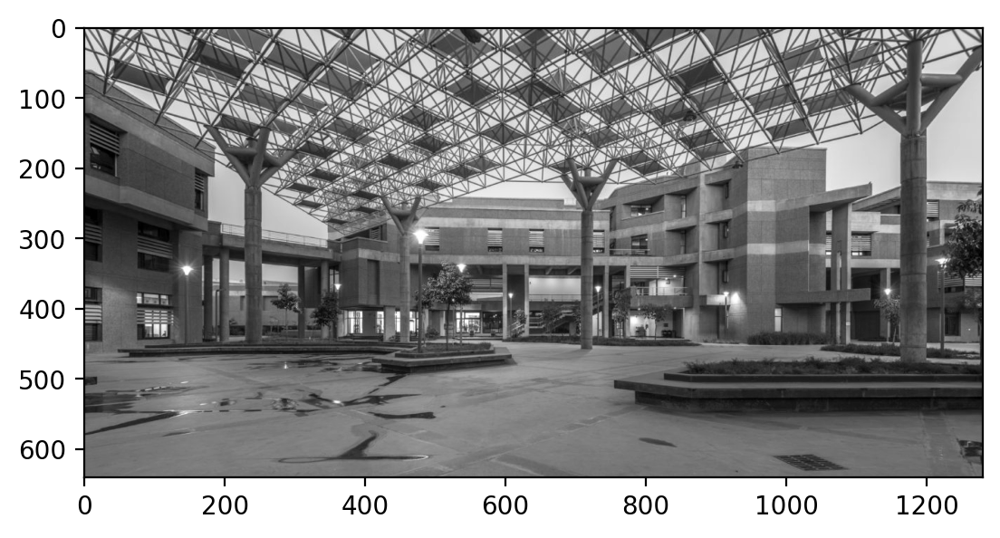

In [7]:
gray_img = torch.tensor(color_img, dtype=torch.float)
gray_img = gray_img.mean(dim=0, keepdim=False)
print(gray_img.shape)
plt.imshow(gray_img, cmap='gray')

### Crop the image

torch.Size([600, 600])


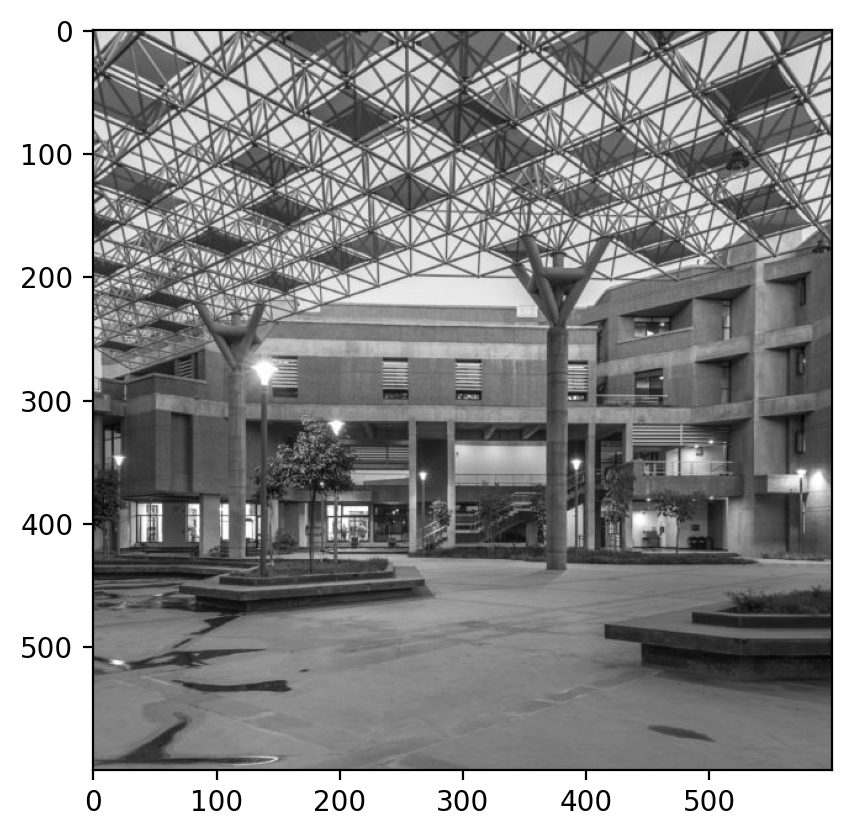

In [8]:
crop = torchvision.transforms.CenterCrop(600)
img_cropped = crop(gray_img)
print(img_cropped.shape)

plt.imshow(img_cropped, cmap='gray')

### Mask some random % of the image

In [9]:
masked_img, mask = mask_image(img_cropped, mask_proportion=0.3)
mask.sum()

tensor(108480)

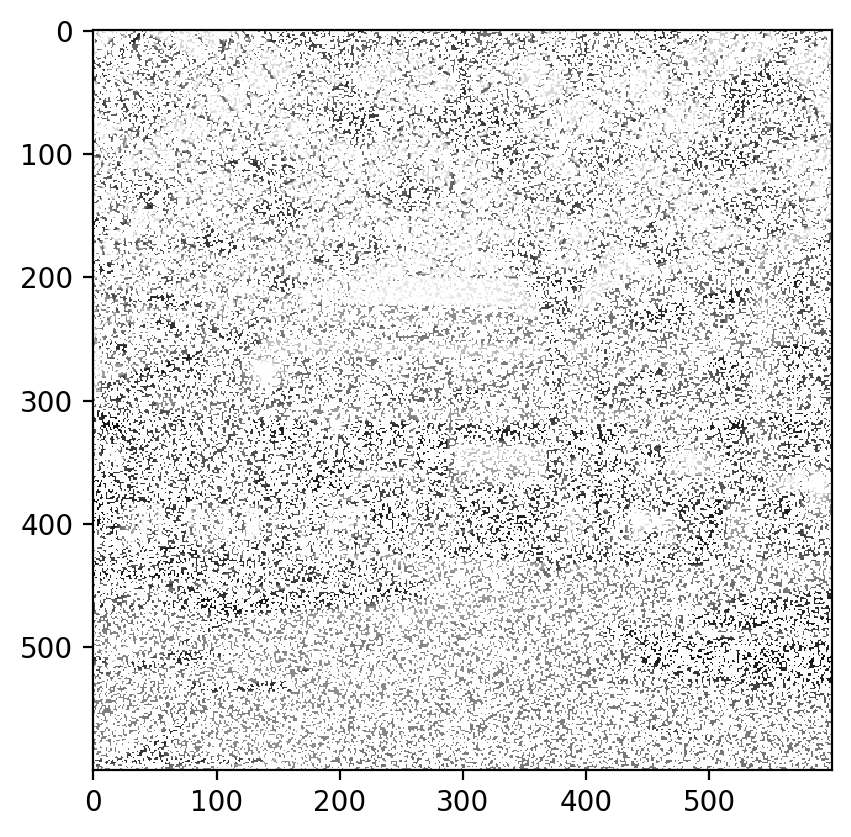

In [10]:
plt.imshow(masked_img, cmap='gray')

### Image reconstruction using Matrix Factorization

In [11]:
def image_reconstruction_random(image_tensor, rank, mask_proportion=0.1, learning_rate=0.01, num_epochs=5000, tol=1e-6, device=torch.device("cpu")):
    """
    Perform image reconstruction using random masking and matrix factorization.
    Args:
        image_tensor (torch.Tensor): The input image tensor to be reconstructed.
        rank (int): The rank for matrix factorization.
        mask_proportion (float, optional): The proportion of the image to mask. Default is 0.1.
        learning_rate (float, optional): The learning rate for matrix factorization. Default is 0.01.
        num_epochs (int, optional): The number of epochs for matrix factorization. Default is 5000.
        tol (float, optional): The tolerance for convergence in matrix factorization. Default is 1e-6.
        device (torch.device, optional): The device to perform computations on. Default is CPU.
    Returns:
        reconstructed (torch.Tensor): The reconstructed image tensor.
        masked_img (torch.Tensor): The masked image tensor.
        loss (float): The final loss value after matrix factorization.
        losses (list): The list of loss values over epochs.
        rmse (float): The Root Mean Square Error between the original and reconstructed image.
        psnr (float): The Peak Signal-to-Noise Ratio between the original and reconstructed image.
    """
    
    image_tensor = image_tensor.to(device)
    # Mask the image
    masked_img, mask = mask_image(image_tensor, mask_proportion)
    # Factorize the masked_img image
    W, H, loss, losses = matrix_factorization(masked_img, rank, learning_rate, num_epochs, tol, device)
    # Reconstruct the image
    reconstructed = torch.mm(W, H)
    # Clamp the images to [0, 1]
    reconstructed = torch.clamp(reconstructed, 0, 1)
    # Calculate RMSE and PSNR
    rmse, psnr = calculate_rmse_psnr(image_tensor, reconstructed)
    # Plot the original and reconstructed
    plot_images(image_tensor, masked_img, reconstructed, rank, mask_proportion)
    
    return reconstructed, masked_img, loss, losses,  rmse, psnr


Iteration 1000, loss: 48.87697219848633
Iteration 2000, loss: 41.28812026977539
Iteration 3000, loss: 37.62129211425781
Iteration 4000, loss: 35.684207916259766
Iteration 5000, loss: 34.79819869995117
Converged at iteration 5814, loss: 34.45172882080078
RMSE: 0.08054604381322861
PSNR: 21.879117965698242


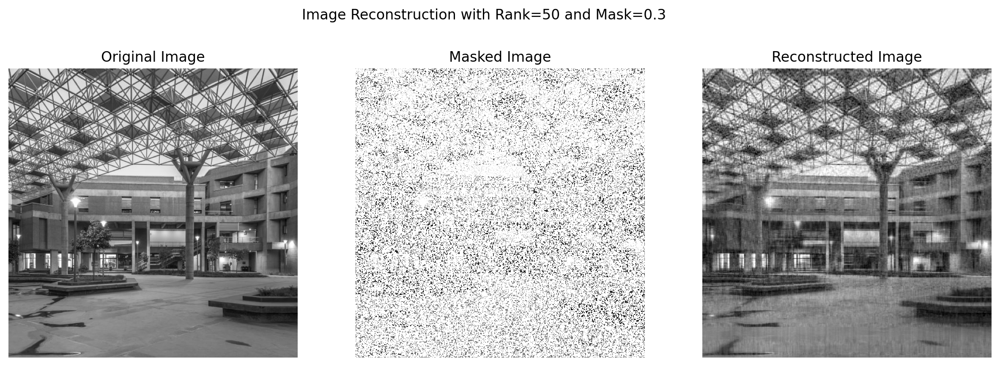

In [12]:
reconstructed_img, masked_img, loss, losses, rmse, psnr = image_reconstruction_random(img_cropped, 50, mask_proportion=0.3, learning_rate=0.01, num_epochs=10000, device=device)

Text(0.5, 1.0, 'Loss vs. Epoch')

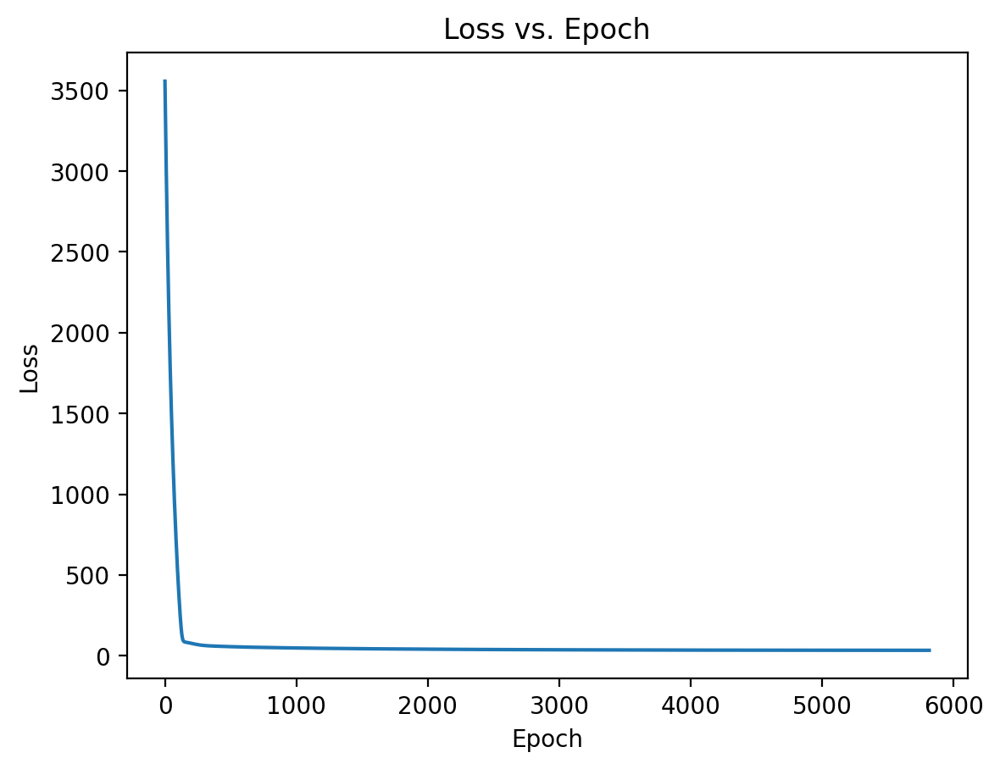

In [13]:
plt.figure()
plt.plot(losses)
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.title("Loss vs. Epoch")

Initially, 30% of the chosen image was masked randomly and matrix factorization was performed to reconstruct the image using rank=50. The gradient descent converged after 5800 iterations.

The RMSE (Root Mean Squared Error) and PSNR (Peak Signal-to-Noise Ratio) were calculated follows:
- RMSE = 0.0805
- PSNR = 21.8791

# Matrix Factorization using Different Ranks

## Image recontruction using ranks = [5,10,20,50,100,150,200,400]

--------------------------------------------------
Evaluating rank: 5
--------------------------------------------------
Iteration 1000, loss: 78.18083953857422
Iteration 2000, loss: 73.98406219482422
Iteration 3000, loss: 73.29161071777344
Converged at iteration 3194, loss: 73.25049591064453
RMSE: 0.1467621773481369
PSNR: 16.66771697998047


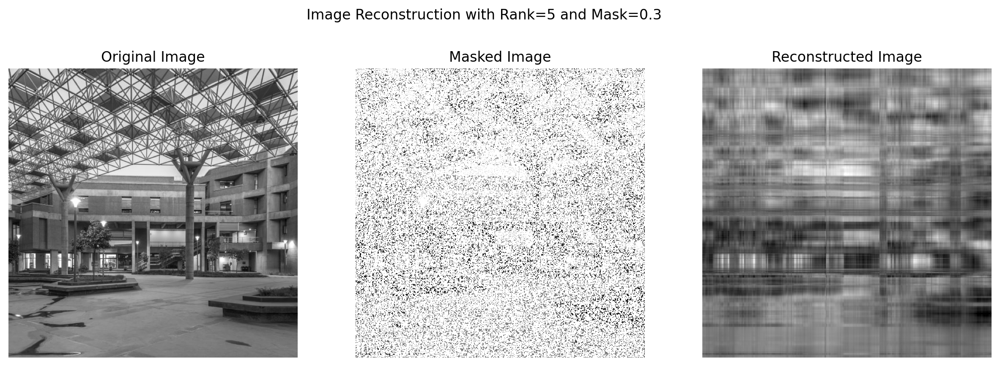




--------------------------------------------------
Evaluating rank: 10
--------------------------------------------------
Iteration 1000, loss: 73.88172912597656
Iteration 2000, loss: 64.40257263183594
Iteration 3000, loss: 62.306758880615234
Converged at iteration 3536, loss: 62.147560119628906
RMSE: 0.12615357339382172
PSNR: 17.982009887695312


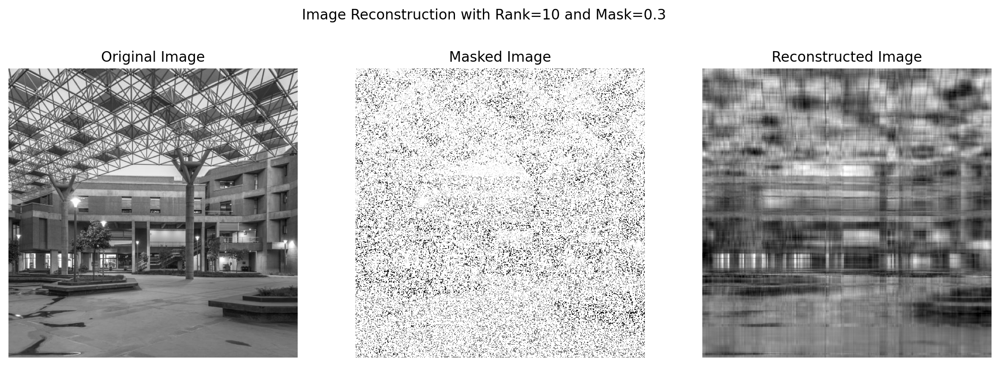




--------------------------------------------------
Evaluating rank: 20
--------------------------------------------------
Iteration 1000, loss: 61.811851501464844
Iteration 2000, loss: 55.08158874511719
Iteration 3000, loss: 52.334293365478516
Iteration 4000, loss: 51.26220703125
Converged at iteration 4632, loss: 50.96134567260742
RMSE: 0.10560295730829239
PSNR: 19.526477813720703


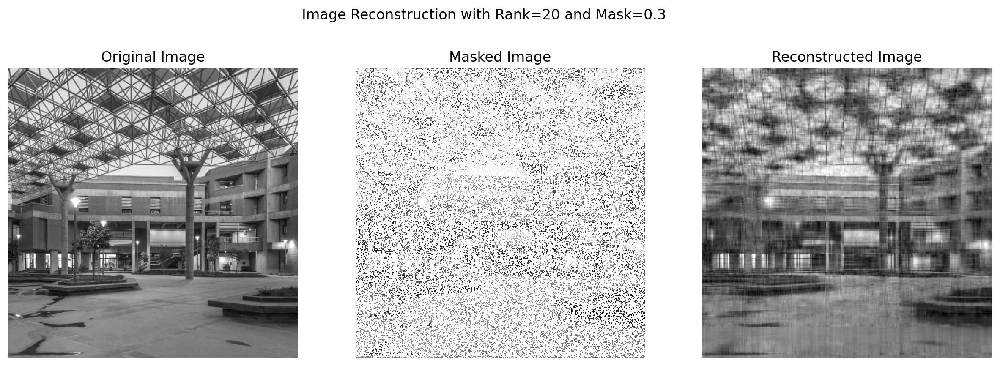




--------------------------------------------------
Evaluating rank: 50
--------------------------------------------------
Iteration 1000, loss: 49.50936508178711
Iteration 2000, loss: 41.40187454223633
Iteration 3000, loss: 37.261653900146484
Iteration 4000, loss: 35.460350036621094
Converged at iteration 4621, loss: 34.86165237426758
RMSE: 0.08136840909719467
PSNR: 21.790884017944336


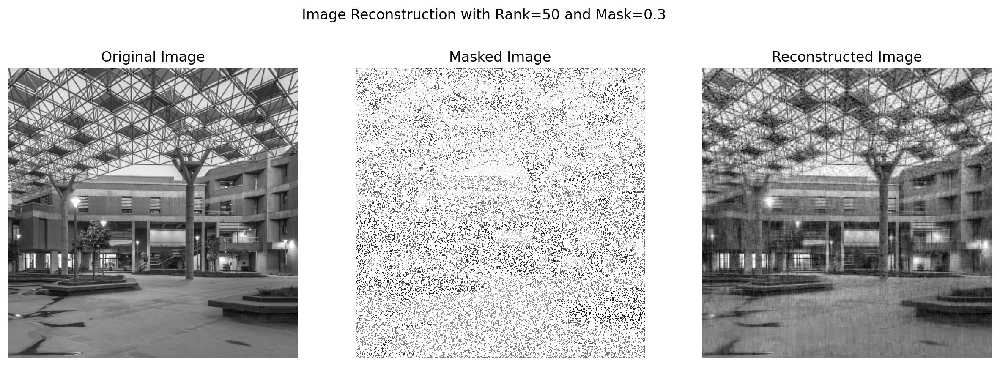




--------------------------------------------------
Evaluating rank: 100
--------------------------------------------------
Iteration 1000, loss: 37.521759033203125
Iteration 2000, loss: 29.730670928955078
Iteration 3000, loss: 25.793209075927734
Iteration 4000, loss: 23.349878311157227
Iteration 5000, loss: 21.671785354614258
Iteration 6000, loss: 20.535459518432617
Iteration 7000, loss: 19.82720375061035
Converged at iteration 7356, loss: 19.543237686157227
RMSE: 0.06383754312992096
PSNR: 23.89847755432129


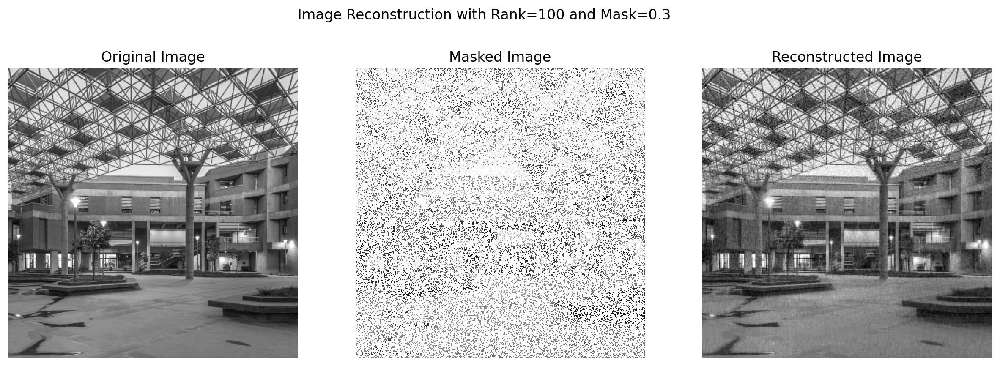




--------------------------------------------------
Evaluating rank: 150
--------------------------------------------------
Iteration 1000, loss: 30.4320068359375
Iteration 2000, loss: 23.666553497314453
Iteration 3000, loss: 20.187625885009766
Iteration 4000, loss: 18.0366268157959
Iteration 5000, loss: 16.546384811401367
Iteration 6000, loss: 15.473443984985352
Converged at iteration 6812, loss: 14.766647338867188
RMSE: 0.06583023816347122
PSNR: 23.631492614746094


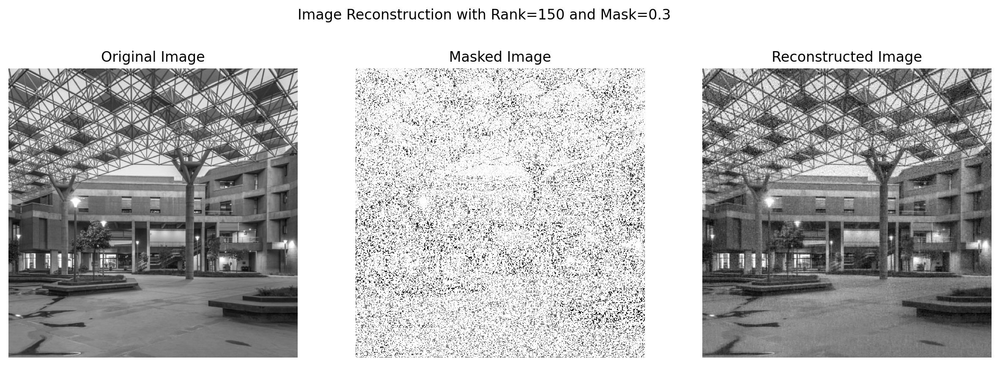




--------------------------------------------------
Evaluating rank: 200
--------------------------------------------------
Iteration 1000, loss: 25.535812377929688
Iteration 2000, loss: 19.660629272460938
Iteration 3000, loss: 16.740854263305664
Converged at iteration 3857, loss: 15.121585845947266
RMSE: 0.07448183000087738
PSNR: 22.55899429321289


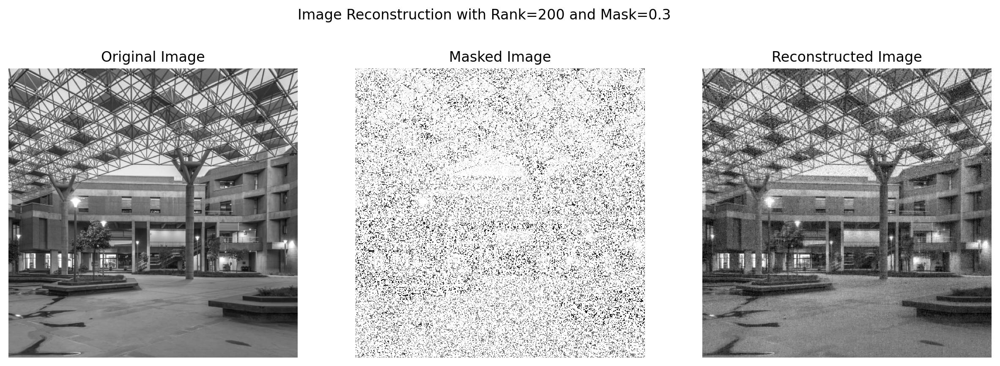




--------------------------------------------------
Evaluating rank: 400
--------------------------------------------------
Iteration 1000, loss: 13.140599250793457
Iteration 2000, loss: 12.863120079040527
Iteration 3000, loss: 12.104313850402832
Iteration 4000, loss: 8.970829963684082
Iteration 5000, loss: 18.687143325805664
Iteration 6000, loss: 11.229662895202637
Iteration 7000, loss: 11.589330673217773
Iteration 8000, loss: 20.804651260375977
Iteration 9000, loss: 9.776169776916504
Iteration 10000, loss: 11.590349197387695
RMSE: 0.27533432841300964
PSNR: 11.20279312133789


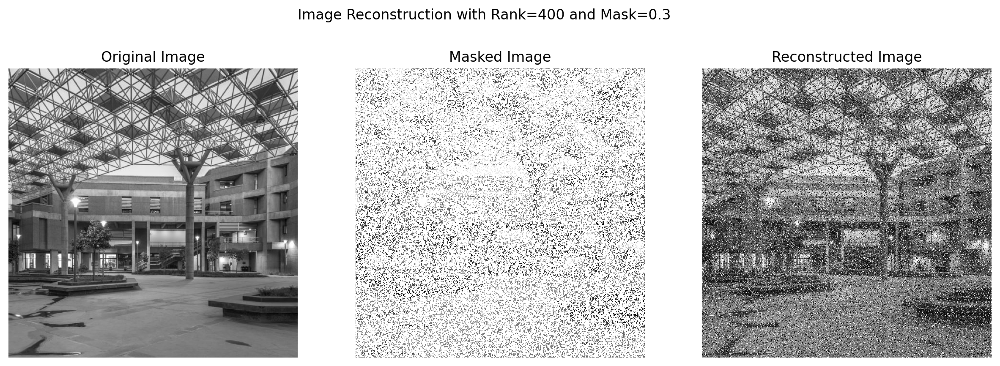

In [25]:
ranks = [5, 10, 20, 50, 100, 150, 200, 400]
results_random = {}
reconstructed_images_random = {}

for rank in ranks:
    print("-"*50)
    print(f"Evaluating rank: {rank}")
    print("-"*50)
    reconstructed_img, masked_img, loss, losses, rmse, psnr = image_reconstruction_random(
        img_cropped, rank, mask_proportion=0.3, learning_rate=0.01, num_epochs=10000, device=device
    )
    results_random[rank] = {'Loss': loss, 'RMSE': rmse, 'PSNR': psnr}
    reconstructed_images_random[rank] = reconstructed_img
    print("\n\n")

## Plotting all reconstructed images

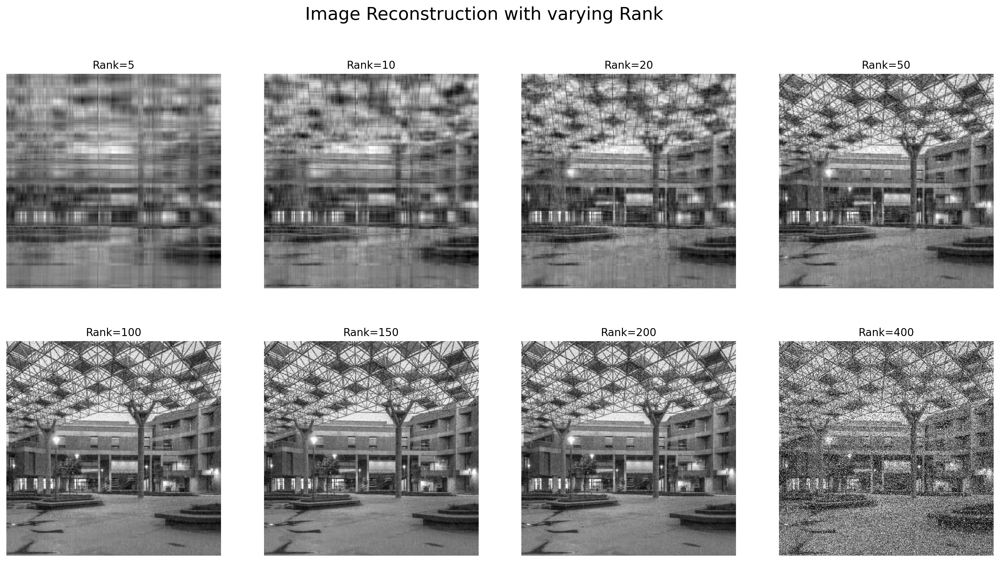

In [26]:
# show original image, masked image once and then reconstructed image for each rank
plt.figure(figsize=(20, 10))
plt.suptitle("Image Reconstruction with varying Rank", fontsize=20)
for i, rank in enumerate(ranks):
    plt.subplot(2, (len(ranks)+1)//2, i+1)
    plt.imshow(reconstructed_images_random[rank].cpu().detach().numpy(), cmap='gray')
    plt.title(f"Rank={rank}")
    plt.axis('off')
plt.show()

## Performance comparison using different ranks

Rank: 5, Loss: 73.2505, RMSE: 0.1468, PSNR: 16.6677
Rank: 10, Loss: 62.1476, RMSE: 0.1262, PSNR: 17.9820
Rank: 20, Loss: 50.9613, RMSE: 0.1056, PSNR: 19.5265
Rank: 50, Loss: 34.8617, RMSE: 0.0814, PSNR: 21.7909
Rank: 100, Loss: 19.5432, RMSE: 0.0638, PSNR: 23.8985
Rank: 150, Loss: 14.7666, RMSE: 0.0658, PSNR: 23.6315
Rank: 200, Loss: 15.1216, RMSE: 0.0745, PSNR: 22.5590
Rank: 400, Loss: 11.5903, RMSE: 0.2753, PSNR: 11.2028


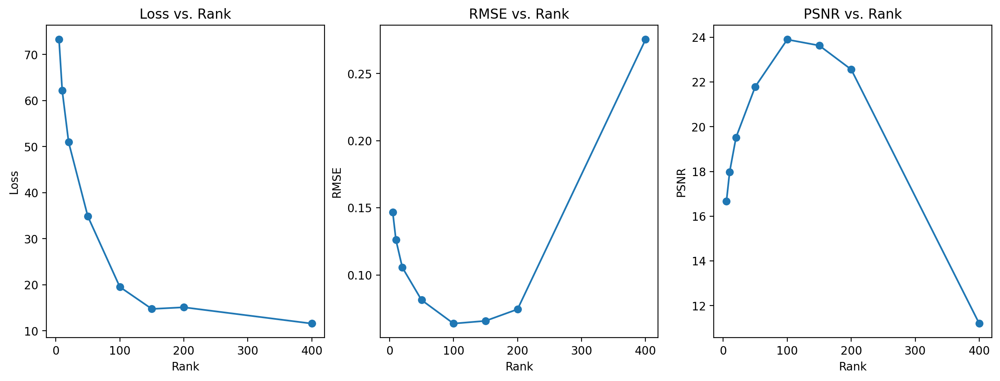

In [31]:
# Print the results for each rank with formatted decimals
for rank, metrics in results_random.items():
    print(f"Rank: {rank}, Loss: {metrics['Loss']:.4f}, RMSE: {metrics['RMSE']:.4f}, PSNR: {metrics['PSNR']:.4f}")
ranks_list = list(results_random.keys())
loss_list = [metrics['Loss'].cpu().detach().numpy() for metrics in results_random.values()]
rmse_list = [metrics['RMSE'] for metrics in results_random.values()]
psnr_list = [metrics['PSNR'] for metrics in results_random.values()]

plt.figure(figsize=(15, 5))
plt.subplot(1, 3, 1)
plt.plot(ranks_list, loss_list, marker='o')
plt.xlabel('Rank')
plt.ylabel('Loss')
plt.title('Loss vs. Rank')
plt.subplot(1, 3, 2)
plt.plot(ranks_list, rmse_list, marker='o')
plt.xlabel('Rank')
plt.ylabel('RMSE')
plt.title('RMSE vs. Rank')
plt.subplot(1, 3, 3)
plt.plot(ranks_list, psnr_list, marker='o')
plt.xlabel('Rank')
plt.ylabel('PSNR')
plt.title('PSNR vs. Rank')
plt.show()

## Find the optimal rank and corresponding metrics based on the highest PSNR


In [12]:
best_psnr = max(psnr_list)
best_psnr_idx = psnr_list.index(best_psnr)
best_rank = ranks_list[best_psnr_idx]
best_rmse = rmse_list[best_psnr_idx]

print("Optimal Rank and Metrics:\n")
print(f"Rank: {best_rank}")
print(f"PSNR: {best_psnr:.4f}")
print(f"RMSE: {best_rmse:.4f}")

Optimal Rank and Metrics:

Rank: 100
PSNR: 22.0187
RMSE: 0.0793


## Observations

We can observe that the Peak Signal-to-Noise Ratio (PSNR) increases up to a certain rank (e.g., 100) and then starts decreasing as the rank continues to rise (e.g., up to 400). This behavior can be explained by the following factors:

#### 1. **Overfitting to Noise**:
   - **Low ranks (<100):** When the rank is low, the reconstructed image provides a more compressed approximation of the original image, capturing the most significant patterns in the data but discarding finer details. This results in a low PSNR since much of the original data is lost.
   - **Optimal Rank (~100):** As the rank increases, the approximation improves because more components are able to contribute to the reconstruction of the matrix, leading to better preservation of data and an increase in PSNR.
   - **High Rank (>100):** Beyond a certain rank, the model begins to capture not only the signal (important patterns) but also the **noise** present in the image. This introduces to **overfitting**, where the approximation fits both signal and random variations (noise), leading to a degradation in reconstruction quality. As a result, the overall **signal-to-noise ratio (SNR)** decreases, which negatively impacts PSNR.
   
#### 2. **Redundancy in the Data**: Real-world data matrices often exhibit redundancy due to correlations between pixels. As the rank increases, new components may provide diminishing returns by duplicating information already captured, leading to less meaningful improvements and causing overfitting.


## Results
- **Initial PSNR increase**: As the rank increases, more of the significant signal is captured, improving the reconstruction and increasing the PSNR.
- **PSNR peak**: TThe optimal rank balances the amount of signal and noise, resulting in the best possible reconstruction.
- **PSNR decline**: At higher ranks, overfitting to noise occurs, reducing the quality of the reconstruction and causing the PSNR to drop.

To prevent this, we can use cross-validation to find the optimal rank or apply regularization to avoid overfitting at higher ranks.


# Image Reconstruction with different Mask Proportions

--------------------------------------------------
Testing with mask proportion: 0.1
--------------------------------------------------
Iteration 1000, loss: 56.87360382080078
Iteration 2000, loss: 48.92239761352539
Iteration 3000, loss: 44.580604553222656
Converged at iteration 3380, loss: 43.57052993774414
RMSE: 0.07926244288682938
PSNR: 22.01865005493164


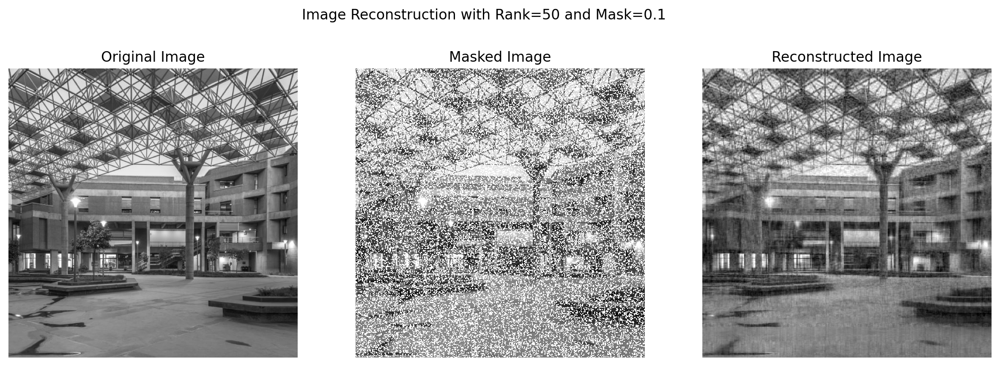




--------------------------------------------------
Testing with mask proportion: 0.3
--------------------------------------------------
Iteration 1000, loss: 49.38352966308594
Iteration 2000, loss: 41.3443489074707
Iteration 3000, loss: 37.56928634643555
Converged at iteration 3710, loss: 36.057735443115234
RMSE: 0.08339497447013855
PSNR: 21.57720184326172


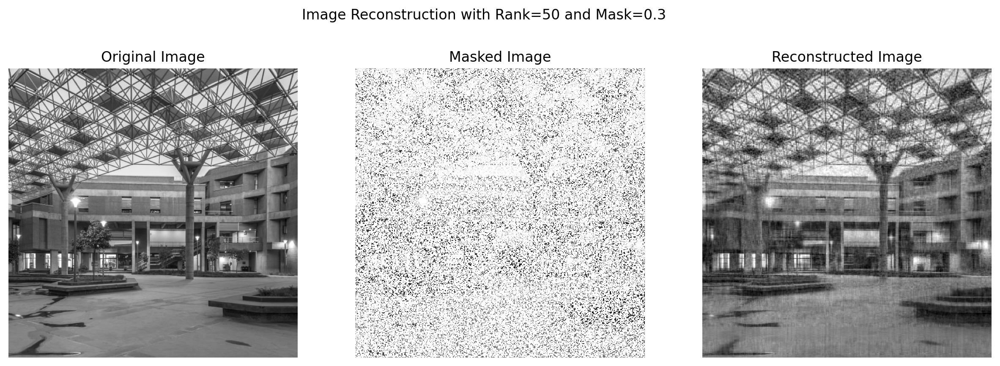




--------------------------------------------------
Testing with mask proportion: 0.5
--------------------------------------------------
Iteration 1000, loss: 39.077476501464844
Iteration 2000, loss: 31.882078170776367
Converged at iteration 2780, loss: 29.16411781311035
RMSE: 0.09937688708305359
PSNR: 20.054292678833008


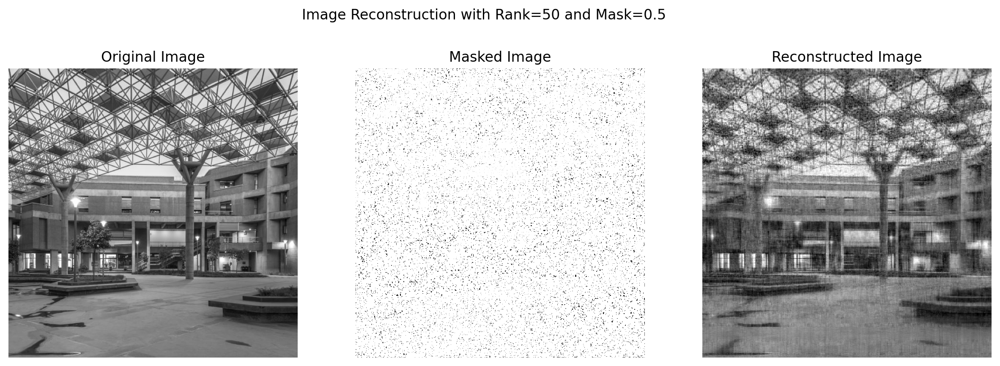




--------------------------------------------------
Testing with mask proportion: 0.7
--------------------------------------------------
Iteration 1000, loss: 23.817005157470703
Iteration 2000, loss: 17.76875114440918
Iteration 3000, loss: 15.443504333496094
Iteration 4000, loss: 14.364585876464844
Converged at iteration 4172, loss: 14.228920936584473
RMSE: 0.15896731615066528
PSNR: 15.973843574523926


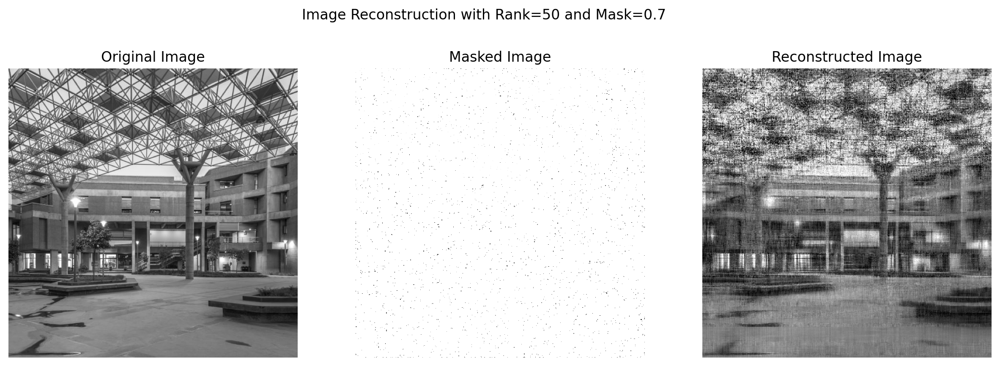




--------------------------------------------------
Testing with mask proportion: 0.9
--------------------------------------------------
Iteration 1000, loss: 1.4615461826324463
Iteration 2000, loss: 1.4347528219223022
Iteration 3000, loss: 1.3670234680175781
Iteration 4000, loss: 3.8117752075195312
Iteration 5000, loss: 1.254178524017334
Iteration 6000, loss: 1.5892692804336548
Iteration 7000, loss: 1.2925074100494385
Iteration 8000, loss: 1.5386343002319336
Iteration 9000, loss: 1.2475454807281494
Iteration 10000, loss: 1.3251181840896606
RMSE: 0.48606282472610474
PSNR: 6.266152381896973


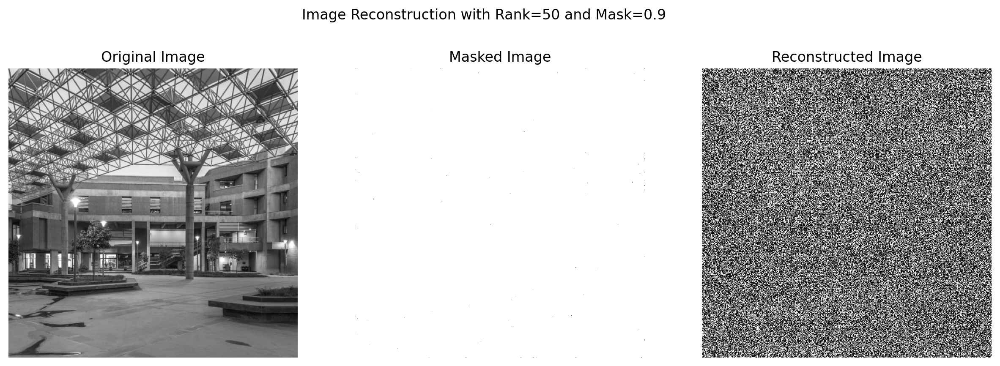

In [19]:
mask_proportions = [0.1, 0.3, 0.5, 0.7, 0.9]

results_random_masks = {}

for proportion in mask_proportions:
    print("-"*50)
    print(f"Testing with mask proportion: {proportion}")
    print("-"*50)

    # Perform image reconstruction
    reconstructed_img, masked_img, loss, losses, rmse, psnr = image_reconstruction_random(
        img_cropped,
        rank=50,
        mask_proportion=proportion,
        learning_rate=0.01,
        num_epochs=10000,
        device=device
    )

    results_random_masks[proportion] = {
        'Loss': loss,
        'RMSE': rmse,
        'PSNR': psnr
    }
    print("\n\n")

## Performance Comparison

Mask Proportion: 0.1, RMSE: 0.0793, PSNR: 22.0187
Mask Proportion: 0.3, RMSE: 0.0834, PSNR: 21.5772
Mask Proportion: 0.5, RMSE: 0.0994, PSNR: 20.0543
Mask Proportion: 0.7, RMSE: 0.1590, PSNR: 15.9738
Mask Proportion: 0.9, RMSE: 0.4861, PSNR: 6.2662


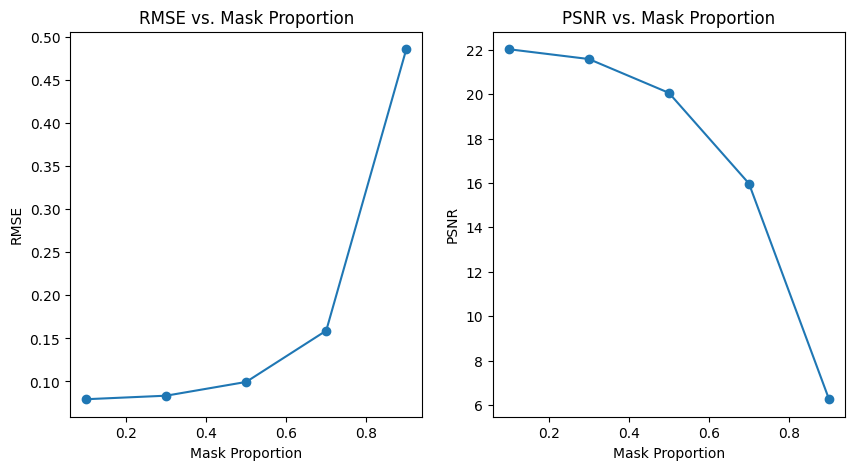

In [9]:
for proportion, metrics in results_random_masks.items():
    print(f"Mask Proportion: {proportion:.1f}, RMSE: {metrics['RMSE']:.4f}, PSNR: {metrics['PSNR']:.4f}")

# Optional: Plot the RMSE and PSNR for different mask proportions
proportions_list = list(results_random_masks.keys())
rmse_list = [metrics['RMSE'] for metrics in results_random_masks.values()]
psnr_list = [metrics['PSNR'] for metrics in results_random_masks.values()]

plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
plt.plot(proportions_list, rmse_list, marker='o')
plt.xlabel('Mask Proportion')
plt.ylabel('RMSE')
plt.title('RMSE vs. Mask Proportion')

plt.subplot(1, 2, 2)
plt.plot(proportions_list, psnr_list, marker='o')
plt.xlabel('Mask Proportion')
plt.ylabel('PSNR')
plt.title('PSNR vs. Mask Proportion')

plt.show()


## Observations

1. **RMSE Increases with Mask Proportion:** As the mask proportion increases, RMSE also increases, indicating larger reconstruction errors. For example, the RMSE at 0.9 mask proportion was significantly higher (0.4861) compared to RMSE at 0.1 (0.0793).

2. **PSNR Decreases with Higher Mask Proportion:** 
   - The Peak Signal-to-Noise Ratio (PSNR), which reflects the quality of reconstruction, decreases drastically as mask proportion increases.
   - Starting from a PSNR of 22.01 at mask proportion 0.1, it falls sharply to 6.26 at 0.9, showing that higher masking worsens the quality of the reconstruction.


**Summary:**
- **Low Mask Proportion (0.1 to 0.3):** The image quality remains good with relatively low error values. Both PSNR and RMSE suggest acceptable reconstruction.
- **Moderate Mask Proportion (0.5):** Image quality starts to degrade, with increased RMSE and decreased PSNR.
- **High Mask Proportion (0.7 to 0.9):** The model struggles with reconstruction, as indicated by high RMSE and very low PSNR and the reconstructed image quality is likely poor.

